# 倒立振子のモデル導出とシミュレーション

## 1. モデル導出と線形化

In [1]:
import numpy as np
import sympy as sp
import scipy.constants as cnst
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import matplotlib.animation as animation

from decimal import *
from scipy.linalg import solve_continuous_are
from scipy.integrate import solve_ivp
from sympy.physics.mechanics import *

from IPython.display import HTML

init_vprinting()

In [2]:
# ------------------------------------------------
# Non-linear state-space equation
# ------------------------------------------------
def func(t, x, func_eq1, func_eq2):
    # Extract state variables
    # State variable x = [theta, theta_dot, phi, phi_dot]^T
    theta, theta_dot, phi, phi_dot = x
    
    # Torque for control
    tau = torque_control(t, x)
    
    # Disturbance
    f_d = force_disturbance(t, x)
    
    # Calculate derivative of state x
    #dxdt = np.zeros_like(x)
    dxdt = []
    for i in range(len(x)):
        dxdt.append(0)
    #print(dxdt)
    dxdt[0] = theta_dot
    dxdt[1] = func_eq1(theta, theta_dot, phi, phi_dot, tau, f_d)
    dxdt[2] = phi_dot
    dxdt[3] = func_eq2(theta, theta_dot, phi, phi_dot, tau, f_d)
    
    # Return result
    return dxdt

In [3]:
# ------------------------------------------------
# Linearized state-space equation
# ------------------------------------------------
def func_lin(t, x):
    # Extract state variables
    # State variable x = [theta, theta_dot, phi, phi_dot]^T
    theta, theta_dot, phi, phi_dot = x
    
    # Torque for control
    tau = torque_control(t, x)
    
    # Disturbance
    f_d = force_disturbance(t, x)
    
    # Input vector
    u = np.array([tau, f_d])
    
    # Calculate derivative of state x
    dxdt = _A @ x + _B @ u
    
    # Return result
    return dxdt

In [4]:
def torque_control(t, x):
    # State variable x = [theta, theta_dot, phi, phi_dot]^T
    theta, theta_dot, phi, phi_dot = x
    if t < 15:
        # State-feedback control
        tau = np.clip(F @ x, -tau_max, tau_max)
    else:
        # Stop controlling
        tau = 0
   
    return tau

In [5]:
# ------------------------------------------------
# Disturbance force
# ------------------------------------------------
def force_disturbance(t, x):
    # State variable x = [theta, theta_dot, phi, phi_dot]^T
    if 5 <= t < 6:
        f_d = 5
    elif 8 <= t < 11:
        f_d = 5 * np.sin(2 * np.pi * 1 * (t - 9))
    else:
        f_d = 0
    
    return f_d

In [6]:
# Function to update frame
def animate(i):
    # Update wheel position
    wheel.center = (_x_w[i], h_wheel)
    
    # Update pendulum attitude
    pendulum.set_data([_x_w[i], _x_w[i] + 2 * _lp * np.sin(_theta[i])],[h_wheel / 2, h_wheel / 2 + 2 * _lp * np.cos(_theta[i])])
    
    # Update pendulum angle text
    text_angle.set_position((_x_w[i] + 2 * _lp * 1.1 * np.sin(_theta[i]), \
                             h_wheel / 2 + 2 * _lp * 1.1 * np.cos(_theta[i])))
    text_angle.set_text(f'${np.degrees(_theta[i]):.3f}\degree$')
    
    # Update time text
    text_time.set_text(f'$t = {_t[i]:.2f}$ s')
    
    # Update force arrow
    kwargs = {'x': _x_w[i] - w_wheel / 2 * np.sign(_f_d[i]) - K_fscale * _f_d[i], 'dx': K_fscale * _f_d[i]}
    #arrow_cont.set_data(**kwargs)
    kwargs = {'x': _x_w[i] + 2 * lp * np.sin(_theta[i]) - K_fscale * _f_d[i], 'y': h_wheel / 2 + 2 * lp * np.cos(_theta[i]), 'dx': K_fscale * _tau_cont[i]}
    #arrow_disturb.set_data(**kwargs)
    
    # Update time lines
    line_time_v_w.set_data([_t[i], _t[i]], [np.min(_v_w), np.max(_v_w)])
    line_time_omega.set_data([_t[i], _t[i]], [np.min(_phi_dot), np.max(_phi_dot)])
    line_time_force.set_data([_t[i], _t[i]], [np.min(_f_d), np.max(_f_d)])
    
    return (wheel, pendulum, text_angle, text_time, line_time_v_w, line_time_omega, line_time_force)

In [7]:
# ------------------------------------------------
# Common symbols and reference frame
# ------------------------------------------------
# Define symbols, Common
t = sp.symbols('t')                                    # Time
g = sp.symbols('g')                                    # Gravity
# Define reference frame, Common
N = ReferenceFrame('N')
O = Point('O')                                         # Origin point
O.set_vel(N, 0)

In [8]:
# ------------------------------------------------
# Pendulum
# ------------------------------------------------
# Symbols
M, I, lp, mu_p = sp.symbols('M I lp mu_p')           # Mass, Inertia, length, and friction
theta = dynamicsymbols('theta')                        # Angle with respect to vertical line
# Reference frame and rigid body
N_p = N.orientnew('N_p', 'Axis', (theta, N.y))             # Define new reference frame for pendulum
N_p.set_ang_vel(N, theta.diff(t, 1) * N.y)               # Set angular velocity of reference frame
C_p = Point('C_p')                                     # Mass center of pendulum
I_tensor = I * outer(N_p.y, N_p.y)                     # Inertia tensor
P = RigidBody('P', C_p, N_p, M, (I_tensor, C_p))       # Definition of rigid body

In [9]:
# ------------------------------------------------
# Wheel
# ------------------------------------------------
# Symbols
m, J, r_w, mu_w = sp.symbols('m J r_w mu_w')
phi = dynamicsymbols('phi')
# Reference frame and rigid body
N_w = N_p.orientnew('N_w', 'Axis', (phi, N_p.y))               # Define new reference frame for pendulum
N_w.set_ang_vel(N_p, phi.diff(t, 1) * N_p.y)                 # Set angular velocity of reference frame
C_w = Point('C_w')                                     # Center of wheel
J_tensor = J * outer(N_w.y, N_w.y)                     # Intertia tensor
W = RigidBody('W', C_w, N_w, M, (J_tensor, C_w))       # Definition of rigid body

In [10]:
# ------------------------------------------------
# Constraints
# ------------------------------------------------
# Set positions
C_w.set_pos(O, r_w * ((theta + phi) * N.x + N.z))
C_p.set_pos(C_w, lp * (sp.sin(theta) * N.x + sp.cos(theta) * N.z))
# Set velocities
C_w.set_vel(N, r_w * (theta.diff(t, 1) + phi.diff(t, 1)) * N.x)
C_p.set_vel(N, (r_w * (theta.diff(t, 1) + phi.diff(t, 1)) 
   + lp * theta.diff(t, 1) * sp.cos(theta)) * N.x \
   - lp * theta.diff(t, 1) * sp.sin(theta) * N.z)
# Point to apply disturbance
P_d = Point('P_d')
P_d.set_pos(C_p, lp * N_p.z)
P_d.set_vel(N, (r_w * (theta.diff(t, 1) + phi.diff(t, 1)) \
    + 2 * lp * theta.diff(t, 1) * sp.cos(theta)) * N.x \
    - 2 * lp * theta.diff(t, 1) * sp.sin(theta) * N.z)

In [11]:
# ------------------------------------------------
# Kinetic energies
# ------------------------------------------------
print('Kinetic energy, Pendulum:')
display(P.kinetic_energy(N))
print('Kinetic energy, Wheel:')
display(W.kinetic_energy(N))

Kinetic energy, Pendulum:


Kinetic energy, Wheel:


In [12]:
# ------------------------------------------------
# Potential energies
# ------------------------------------------------
P.potential_energy = m * g * lp * sp.cos(theta)
print('Potential energy of pendulum:')
display(P.potential_energy)

Potential energy of pendulum:


In [13]:
# ------------------------------------------------
# Euler-Lagrange method
# ------------------------------------------------
# Get Lagrangian
L = Lagrangian(N, P, W)
print('Lagrangian:')
display(L)
# Generalized coordinate
q = [theta, phi]

# Generalized forces and torques
# Control torque
tau = sp.symbols('tau')
f_control = [(N_p, -tau * N_p.y), (N_w, tau * N_w.y)]

# Friction or dissipative
# Friction between pendulum and wheel
tau_fp = sp.symbols('tau_fp')
tau_fp = mu_p * phi.diff(t, 1)
# Friction between pendulum and wheel and friction between wheel and floor
tau_fw = sp.symbols('tau_fw')
tau_fw = -mu_p * phi.diff(t, 1) - mu_w * (theta.diff(t, 1) + phi.diff(t, 1))
f_dissipation = [(N_p, tau_fp * N_p.y), (N_w, tau_fw * N_w.y)]

# Disturbance force
f_d = sp.symbols('f_d')
f_disturbance = [(P_d, f_d * N.x)]
# Summation of generalized forces and torques
f = f_control + f_dissipation + f_disturbance
# Define a Lagrange's method
LM = LagrangesMethod(L, q, forcelist = f, frame = N)
# Derive equation of motion!
eom = LM.form_lagranges_equations()
print('Equation of motion:')
display(eom[0].simplify().factor())
display(eom[1].simplify().factor())

Lagrangian:


Equation of motion:


Equation with respect to d^2 theta / dt^2


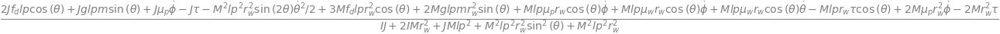

Equation with respect to d^2 phi / dt^2


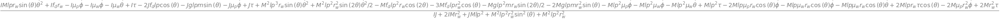

In [14]:
# ------------------------------------------------
# Angular acceleration
# ------------------------------------------------
# Solve equation of motion with respect to the second-order variables
sol = sp.solve(eom, [theta.diff(t, 2), phi.diff(t, 2)])
eq1 = sol[theta.diff(t, 2)].simplify()
print('Equation with respect to d^2 theta / dt^2')
display(eq1)
eq2 = sol[phi.diff(t, 2)].simplify()
print('Equation with respect to d^2 phi / dt^2')
display(eq2)

## シミュレーション

In [15]:
# ------------------------------------------------
# Euler-Lagrange method
# ------------------------------------------------
# Get Lagrangian
L = Lagrangian(N, P, W)
print('Lagrangian:')
display(L)
# Generalized coordinate
q = [theta, phi]
# Generalized forces and torques
# Control torque
tau = dynamicsymbols('tau')

f_control = [(N_p, -tau * N_p.y), (N_w, tau * N_w.y)]
# Friction or dissipative
# Friction between pendulum and wheel
tau_fp = sp.symbols('tau_fp')
tau_fp = mu_p * phi.diff(t, 1)
# Friction between pendulum and wheel and friction between wheel and floor
tau_fw = sp.symbols('tau_fw')
tau_fw = -mu_p * phi.diff(t, 1) - mu_w * (theta.diff(t, 1) + phi.diff(t, 1))
f_dissipation = [(N_p, tau_fp * N_p.y), (N_w, tau_fw * N_w.y)]
# Disturbance force
f_d = dynamicsymbols('f_d')
f_disturbance = [(P_d, f_d * N.x)]
# Summation of generalized forces and torques
f = f_control + f_dissipation + f_disturbance
# Define a Lagrange's method
LM = LagrangesMethod(L, q, forcelist = f, frame = N)
# Derive equation of motion!
eom = LM.form_lagranges_equations()
print('Equation of motion:')
display(eom[0].simplify().expand())
display(eom[1].simplify().expand())

Lagrangian:


Equation of motion:


Equation with respect to d^2 theta / dt^2


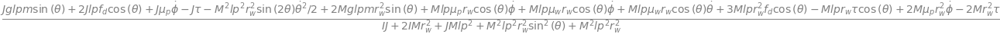

Equation with respect to d^2 phi / dt^2


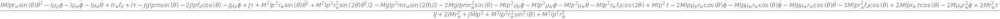

In [16]:
# ------------------------------------------------
# Angular acceleration
# ------------------------------------------------
# Solve equation of motion with respect to the second-order variables
sol = sp.solve(eom, [theta.diff(t, 2), phi.diff(t, 2)])
eq1 = sol[theta.diff(t, 2)].simplify()
print('Equation with respect to d^2 theta / dt^2')
display(eq1)
eq2 = sol[phi.diff(t, 2)].simplify()
print('Equation with respect to d^2 phi / dt^2')
display(eq2)

In [17]:
# ------------------------------------------------
# Linearization
# ------------------------------------------------
# Set operating point
op_point = {theta: 0, theta.diff(t, 1): 0, phi: 0, phi.diff(t, 1): 0}
# Linearize!
kwargs = {'q_ind': [theta, phi], 'qd_ind': [theta.diff(t, 1), phi.diff(t, 1)], \
          'A_and_B': True, 'op_point': op_point, 'simplify': True}
A, B, inp_vec = LM.linearize(**kwargs)

In [18]:
# ------------------------------------------------
# Results of linearization
# ------------------------------------------------
print('A =')
display(A)
print('B =')
display(B)
print('inp_vec =')
display(inp_vec)

A =


⎡                   0                      0                     1                                                              0          
⎢                                                                                                                                          
⎢                   0                      0                     0                                                              1          
⎢                                                                                                                                          
⎢                ⎛           2⎞                                                                                                            
⎢         g⋅lp⋅m⋅⎝J + 2⋅M⋅r_w ⎠                             M⋅lp⋅μ_w⋅r_w                                 J⋅μₚ + M⋅lp⋅μₚ⋅r_w + M⋅lp⋅μ_w⋅r_w 
⎢────────────────────────────────────────  0  ────────────────────────────────────────                   ──────────────────────────────────
⎢               2   

B =


⎡                   0                                         0                    ⎤
⎢                                                                                  ⎥
⎢                   0                                         0                    ⎥
⎢                                                                                  ⎥
⎢             ⎛             2⎞                                            2        ⎥
⎢          lp⋅⎝2⋅J + 3⋅M⋅r_w ⎠                     -J - M⋅lp⋅r_w - 2⋅M⋅r_w         ⎥
⎢────────────────────────────────────────  ────────────────────────────────────────⎥
⎢               2         2    2   2    2                 2         2    2   2    2⎥
⎢I⋅J + 2⋅I⋅M⋅r_w  + J⋅M⋅lp  + M ⋅lp ⋅r_w   I⋅J + 2⋅I⋅M⋅r_w  + J⋅M⋅lp  + M ⋅lp ⋅r_w ⎥
⎢                                                                                  ⎥
⎢                     2                 2               2                       2  ⎥
⎢I⋅r_w - 2⋅J⋅lp - M⋅lp ⋅r_w - 3⋅M⋅lp⋅r_w    I + J + M⋅lp  + 2⋅M⋅l

inp_vec =


⎡f_d⎤
⎢   ⎥
⎣ τ ⎦

In [19]:
# ------------------------------------------------
# Numerical parameter examples
# ------------------------------------------------
# Reset format
np.set_printoptions(formatter = None)
# Pendulum
_M = 0.75                    # Mass of pendulum, kg
_lp = 0.12                    # Half length of pendulum, m
_I = _M * _lp**2 / 3        # Inertia of pendulum
print('I : ' + str(_I))
_mu_p = 0.05                 # Friction of pendulum, N/(rad/s)
# Wheel
_m = 0.15                    # Mass of wheel, kg
_r_w = 0.040                    # Radius of wheel, m
_J = _m * _r_w**2 / 2        # Inertia of wheel, kg m**2
print('J : ' + str(_J))
_mu_w = 0.05                 # Friction of wheel, N/(rad/s)
# Gravity
_g = cnst.g                  # Gravity on Earth, m/s**2

I : 0.0036000000000000003
J : 0.00012


In [20]:
# ------------------------------------------------
# Lambdification of SymPy results
# ------------------------------------------------
# Give derivatives new name
theta_dot, phi_dot = sp.symbols('theta_dot phi_dot')
# Definition of the lambdified functions
_eq1 = eq1.subs([(theta.diff(t, 1), theta_dot), (phi.diff(t, 1), phi_dot), \
    (m, _m), (lp, _lp), (I, _I), (M, _M), (r_w, _r_w), (J, _J), \
    (mu_p, _mu_p), (mu_w, _mu_w), (g, _g)])
func_eq1 = sp.lambdify([theta, theta_dot, phi, phi_dot, tau, f_d], \
    _eq1, 'numpy')
_eq2 = eq2.subs([(theta.diff(t, 1), theta_dot), (phi.diff(t, 1), phi_dot), \
    (m, _m), (lp, _lp), (I, _I), (M, _M), (r_w, _r_w), (J, _J), \
    (mu_p, _mu_p), (mu_w, _mu_w), (g, _g)])
func_eq2 = sp.lambdify([theta, theta_dot, phi, phi_dot, tau, f_d], \
    _eq2, 'numpy')

In [21]:
# ------------------------------------------------
# Linearization results to NumPy arrays, A and B
# ------------------------------------------------
# NOTE:
#  x = [theta, phi, theta_dot, phi_dot]^T
#  u = [f_d, tau]^T
# The A matrix
_A_tmp = sp.matrix2numpy(A.subs([(M, _M), (lp, _lp), (I, _I), (m, _m), \
    (r_w, _r_w), (J, _J), (mu_p, _mu_p), (mu_w, _mu_w), (g, _g)]), \
    dtype = 'float64')
# The B matrix
_B_tmp = sp.matrix2numpy(B.subs([(m, _m), (lp, _lp), (I, _I), (M, _M), \
    (r_w, _r_w), (J, _J), (mu_p, _mu_p), (mu_w, _mu_w), (g, _g)]), \
    dtype = 'float64')
# Change raw and column orders to fit existing routines
_A_tmp = _A_tmp[[0, 2, 1, 3], :]
_A = _A_tmp[:, [0, 2, 1, 3]]
print(f'A = \n{_A}')
_B_tmp = _B_tmp[[0, 2, 1, 3], :]
_B = _B_tmp[:, [1, 0]]
print(f'B = \n{_B}')

A = 
[[  0.           1.           0.           0.        ]
 [ 19.06848611   7.71604938   0.          20.83333333]
 [  0.           0.           0.           1.        ]
 [-46.30918056 -38.58024691   0.         -90.27777778]]
B = 
[[   0.            0.        ]
 [-262.34567901   19.75308642]
 [   0.            0.        ]
 [1033.95061728  -32.09876543]]


In [22]:
# ------------------------------------------------
# LQR, linear quadratic regulator
# ------------------------------------------------
# Weights
_B_c = np.array([_B[:, 0]]).T    # As a column vector here
_Q = np.diag([10, 10, 100, 10])
_R = np.array([[100]])
# Solve Riccati equation
_P = solve_continuous_are(_A, _B_c, _Q, _R)
_F = (-np.linalg.inv(_R) @ _B_c.T @ _P)[0]
print(f'State-feedback gain _F =\n{_F}\n')
# Check eigenvalues of closed-loop system
w_lqr, v_lqr = np.linalg.eig(_A + _B_c * _F)
print(f'Eigenvalues of closed-loop system =\n{w_lqr}')

State-feedback gain _F =
[5.09239835 1.36077706 1.         0.08086783]

Eigenvalues of closed-loop system =
[-346.9834145    -2.05672616   -2.30781192   -4.59441343]


In [23]:
# ------------------------------------------------
# Torque for control
# ------------------------------------------------
# State feedback gain, obtained by linearization and LQR!
F = _F
# Maximum torque, Nm
tau_max = 3

In [24]:
# ------------------------------------------------
# Solution of non-lin. and lin dynamics by SciPy
# ------------------------------------------------
# NumPy array for time
t_start = 0.0
t_end = 20.0                      # Time to end simulation, s
t_span = [t_start, t_end]
dt = 0.01                         # Time slice, 
_t = np.arange(0, t_end, dt)      # Time array

# Initial conditions
theta_0 = np.radians(15)          # Initial pendulum angle, rad
x_w0 = 1                          # Initial wheel positon, m
phi_0 = x_w0 / _r_w - theta_0       # Initial wheel angle with respect to pendulum
x0 = [theta_0, 0, phi_0, 0]       # Initial state
# Now solve it, non-linear
sol = solve_ivp(func, t_span, x0, t_eval = _t, args = [func_eq1, func_eq2])
# Now solve it, linearized
sol_lin = solve_ivp(func_lin, t_span, x0, t_eval = _t)

In [25]:
# ------------------------------------------------
# Post-processing of the solution, Non-linear
# ------------------------------------------------
# State variables
_theta = (sol.y[0,:].T + np.pi) % (2 * np.pi) - np.pi
_theta_dot = sol.y[1,:].T
_phi = (sol.y[2,:].T + np.pi) % (2 * np.pi) - np.pi
_phi_dot = sol.y[3,:].T
# Position and velocity of wheel, theta + phi
_x_w = _r_w * (sol.y[0,:].T + sol.y[2,:].T)
_v_w = _r_w * (sol.y[1,:].T + sol.y[3,:].T)
# Reproduce control torque and disturbance force
_tau_cont = np.zeros_like(_t)
_f_d = np.zeros_like(_t)
for i, __t in enumerate(_t):
    _tau_cont[i] = torque_control(__t, sol.y[:,i])
    _f_d[i] = force_disturbance(__t, sol.y[:,i])
    #_f_d[i] = 0

In [26]:
# ------------------------------------------------
# Post-processing of the solution, linear
# ------------------------------------------------
# State variables
_theta_lin = (sol_lin.y[0,:].T + np.pi) % (2 * np.pi) - np.pi
_theta_dot_lin = sol_lin.y[1,:].T
_phi_lin = (sol_lin.y[2,:].T + np.pi) % (2 * np.pi) - np.pi
_phi_dot_lin = sol_lin.y[3,:].T
# Position and velocity of wheel, theta + phi
_x_w_lin = _r_w * (sol_lin.y[0,:].T + sol.y[2,:].T)
_v_w_lin = _r_w * (sol_lin.y[1,:].T + sol.y[3,:].T)
# Reproduce control torque and disturbance force
_tau_cont_lin = np.zeros_like(_t)
_f_d_lin = np.zeros_like(_t)
for i, __t in enumerate(_t):
    _tau_cont_lin[i] = torque_control(__t, sol_lin.y[:,i])
    _f_d_lin[i] = force_disturbance(__t, sol_lin.y[:,i])
    #_f_d_lin[i] = 0

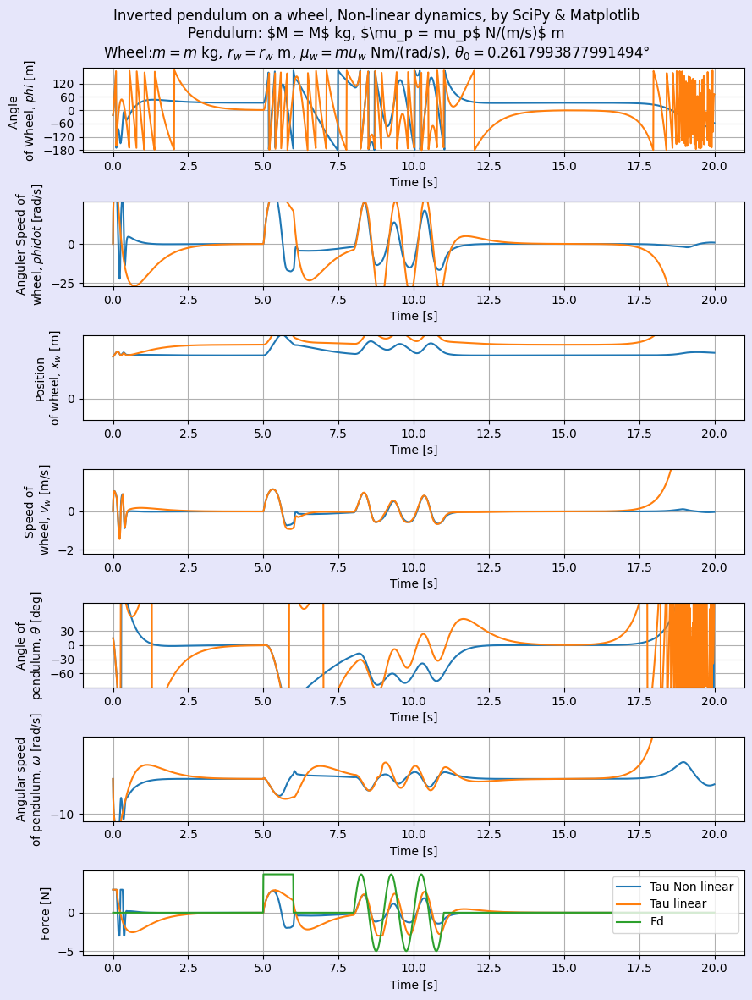

In [27]:
# Time-domain plots
plt.rcParams["font.size"] = 10
fig, ax = plt.subplots(7, 1, figsize = (9, 12))
fig.patch.set_facecolor('lavender')
#fig.suptitle(f'Inverted pendulum on a wheel, $M = {M}$ kg, $m = {m}$ kg, $2lp = {2 * lp}$ m, $\mu_p = {mu_p}$ N/(m/s), $\mu_p = {mu_p}$ Nm/(rad/s)')
fig.suptitle(f'Inverted pendulum on a wheel, Non-linear dynamics, by SciPy & Matplotlib\nPendulum: $M = {M}$ kg, $\mu_p = {mu_p}$ N/(m/s)$ m\nWheel:$m = {m}$ kg, $r_w = {r_w}$ m, $\mu_w = {mu_w}$ Nm/(rad/s), $\\theta_0 = {theta_0}\degree$')

# Plot Angle of wheel
ax[0].plot(_t, np.array([np.degrees(_phi), np.degrees(_phi_lin)]).T, label = ['Non linear', 'Linear'])
ax[0].set_xlabel('Time [s]')
ax[0].set_ylabel('Angle \nof Wheel, $phi$ [m]')
ax[0].set_yticks(range(-180, 180, 60))
ax[0].set_ylim(-190, 190)
ax[0].grid()

# Plot Anguler velosity of wheel
ax[1].plot(_t, np.array([_phi_dot, _phi_dot_lin]).T, label = ['Non linear', 'Linear'])
ax[1].set_xlabel('Time [s]')
ax[1].set_ylabel('Anguler Speed of\nwheel, $phi dot$ [rad/s]')
ax[1].set_yticks(range(-25, 25, 25))
ax[1].set_ylim(-27, 27)
ax[1].grid()

# Plot position of wheel
ax[2].plot(_t, np.array([_x_w, _x_w_lin]).T, label = ['Non linear', 'Linear'])
ax[2].set_xlabel('Time [s]')
ax[2].set_ylabel('Position\nof wheel, $x_w$ [m]')
ax[2].set_yticks(range(0, 1, 2))
ax[2].set_ylim(-0.5, 1.5)
ax[2].grid()

# Plot Speed of wheel
ax[3].plot(_t, np.array([_v_w, _v_w_lin]).T, label = ['Non linear', 'Linear'])
ax[3].set_xlabel('Time [s]')
ax[3].set_ylabel('Speed of\n wheel, $v_w$ [m/s]')
ax[3].set_yticks(range(-2, 2, 2))
ax[3].set_ylim(-2.2, 2.2)
ax[3].grid()

# Plot Angle of pendulum
ax[4].plot(_t, np.array([np.degrees(_theta), np.degrees(_theta_lin)]).T, label = ['Non linear', 'Linear'])
ax[4].set_xlabel('Time [s]')
ax[4].set_ylabel('Angle of\npendulum, $\\theta$ [deg]')
ax[4].set_yticks(range(-60, 60, 30))
ax[4].set_ylim(-90, 90)
ax[4].grid()

# Plot Angular speed of pendulum 
ax[5].plot(_t, np.array([_theta_dot, _theta_dot_lin]).T, label = ['Non linear', 'Linear'])
ax[5].set_xlabel('Time [s]')
ax[5].set_ylabel('Angular speed\nof pendulum, $\\omega$ [rad/s]')
ax[5].set_yticks(range(-10, 0, 10))
ax[5].set_ylim(-12, 12)
ax[5].grid()

# Control force
ax[6].plot(_t, np.array([_tau_cont, _tau_cont_lin, _f_d]).T, label = ['Tau Non linear', 'Tau linear', 'Fd'])
ax[6].set_xlabel('Time [s]')
ax[6].set_ylabel('Force [N]')
ax[6].legend(loc = 'upper right')
ax[6].set_yticks(range(-5, 5, 5))
ax[6].grid()

fig.tight_layout()

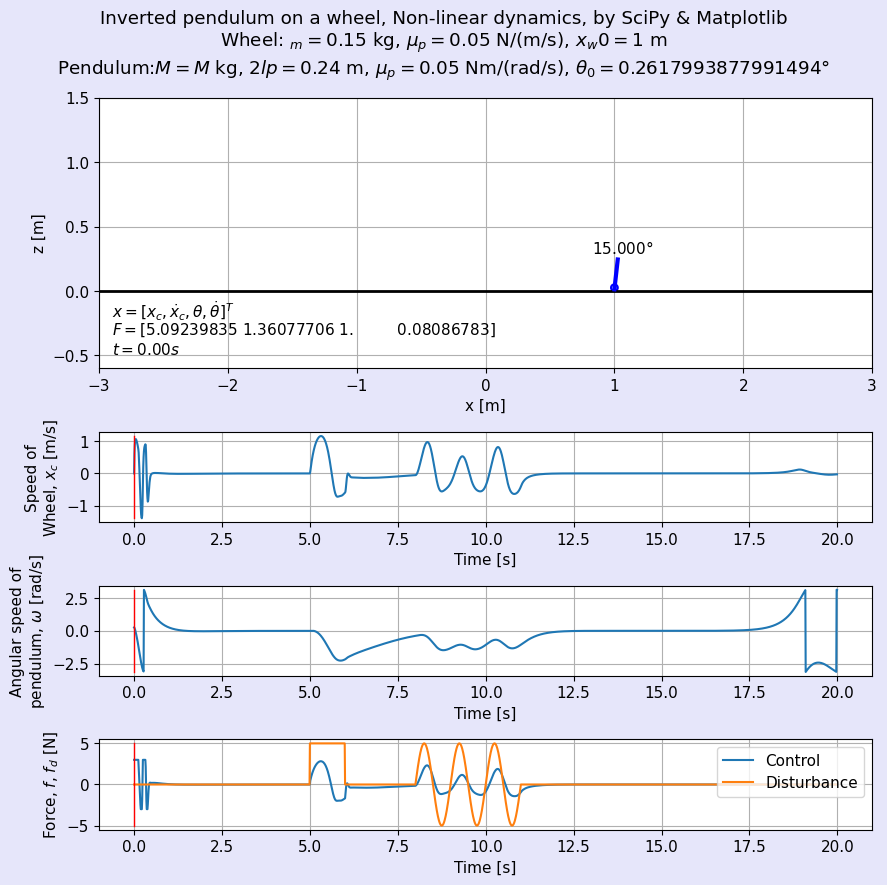

In [28]:
# Animate
# Animation setting
w_wheel = 0.026          # Width of wheel, m
h_wheel = 0.026         # Height of wheel, m
K_tscale = 3           # Size of theatre

# Plot theatre
plt.rcParams["font.size"] = 11
fig, ax = plt.subplots(4, 1, figsize = (9, 9), gridspec_kw={'height_ratios': [3, 1, 1, 1]})
fig.patch.set_facecolor('lavender')
ax[0].set_aspect('equal')
fig.suptitle(f'Inverted pendulum on a wheel, Non-linear dynamics, by SciPy & Matplotlib\nWheel: $_m = {_m}$ kg, $\mu_p = {_mu_p}$ N/(m/s), $x_w0 = {x_w0}$ m\nPendulum:$M = {M}$ kg, $2lp = {2 * _lp}$ m, $\mu_p = {_mu_p}$ Nm/(rad/s), $\\theta_0 = {theta_0}\degree$')

# Set axis for animation
ax[0].set_xlim(-K_tscale, K_tscale)
ax[0].set_xlabel('x [m]')
ax[0].set_ylim(-K_tscale/5, K_tscale/2)
ax[0].set_ylabel('z [m]')
ax[0].grid()
ax[0].set_axisbelow(True)

# Show state feedback gain
ax[0].text(-K_tscale + 0.1, -K_tscale / 20, '$x = [x_{c}, \\dot{x}_{c}, \\theta, \\dot{\\theta}]^T$', va = 'center')
ax[0].text(-K_tscale + 0.1, -2 * K_tscale / 20, f'$F = ${F}', va = 'center')

# Show time
text_time = ax[0].text(-K_tscale + 0.1, -3 * K_tscale / 20, f'$t = {_t[0]:.2f} s$', va = 'center')

# Draw floor
ax[0].plot([-10, 10], [0, 0], lw = 2, color = 'black')

# Draw wheel
wheel = patches.Circle(xy = (_x_w[0], h_wheel), radius = h_wheel, lw = 1.5, ec = 'blue', fc = 'lightblue')
ax[0].add_patch(wheel)

# Draw pendulum
pendulum, = ax[0].plot([_x_w[0], _x_w[0] + h_wheel],[h_wheel / 2, h_wheel / 2 + 2 * _lp * np.cos(_theta[0])], \
    lw = 3, color = 'blue')

# Show angle of pendulum over it
text_angle = ax[0].text(_x_w[0] + 2 * _lp * 1.1 * np.sin(_theta[0]), \
                        h_wheel / 2 + 2 * _lp * 1.1 * np.cos(_theta[0]), \
                        f'${np.degrees(_theta[0]):.3f}\degree$', ha = 'center', va = 'bottom')

# Show control and disturbance forces as arrows
K_fscale = K_tscale / 40
arrow_cont = ax[0].arrow(w_wheel / 2 * np.sign(_f_d[0]) - K_fscale * _f_d[0], \
    h_wheel / 2, K_fscale * _f_d[0], 0, length_includes_head = True, width = K_tscale * 0.01, color = 'blue', alpha = 0.6)

arrow_disturb = ax[0].arrow(_theta[0] + 2 * lp * np.sin(_theta[0]) - K_fscale * _f_d[0], h_wheel / 2 + 2 * lp * np.cos(_theta[0]), \
    K_fscale * _f_d[0], 0, length_includes_head = True, width = K_tscale * 0.01, color = 'orange', alpha = 0.6)

# Time-domain plots
# Plot speed of wheel
ax[1].plot(_t, _v_w)
line_time_v_w, = ax[1].plot([_t[0], _t[0]], [np.min(_v_w), np.max(_v_w)], lw = 1, c = 'red') 
ax[1].set_xlabel('Time [s]')
ax[1].set_ylabel('Speed of\nWheel, $x_{c}$ [m/s]')
ax[1].grid()

# Plot angular speed of pendulum
ax[2].plot(_t, _theta)
line_time_omega, = ax[2].plot([_t[0], _t[0]], [np.min(_theta), np.max(_theta)], lw = 1, c = 'red') 
ax[2].set_xlabel('Time [s]')
ax[2].set_ylabel('Angular speed of\npendulum, $\\omega$ [rad/s]')
ax[2].grid()

# Plot forces
ax[3].plot(_t, np.array([_tau_cont, _f_d]).T, label = ['Control', 'Disturbance'])
line_time_force, = ax[3].plot([_t[0], _t[0]], [np.min(_f_d), np.max(_f_d)], lw = 1, c = 'red') 
ax[3].set_xlabel('Time [s]')
ax[3].set_ylabel('Force, $f$, $f_{d}$ [N]')
ax[3].legend(loc = 'upper right')
ax[3].grid()

fig.tight_layout()

In [29]:
# Create animation
ani = animation.FuncAnimation(fig, animate, \
    frames = np.arange(0, len(_t), 5), interval = dt * 5 * 1000, blit = True)

# Show animation
HTML(ani.to_jshtml())

Animation size has reached 21115509 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
